# **Importing Library**




In [ ]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats

In [ ]:
import warnings
warnings.filterwarnings('ignore')

In [ ]:
sns.set_style(style = 'whitegrid')

# **Importing Data**

In [ ]:
df=pd.read_csv('https://raw.githubusercontent.com/dsrscientist/Dataset2/main/temperature.csv')
df.head()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,0.0,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,0.159444,0.127727,0.0,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,0.204091,0.142125,0.0,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,0.161157,0.134249,0.0,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,0.178892,0.170021,0.0,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5


# ***EDA***

## preprocessing

In [ ]:
df.shape

(7752, 25)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7752 entries, 0 to 7751
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   station           7750 non-null   float64
 1   Date              7750 non-null   object 
 2   Present_Tmax      7682 non-null   float64
 3   Present_Tmin      7682 non-null   float64
 4   LDAPS_RHmin       7677 non-null   float64
 5   LDAPS_RHmax       7677 non-null   float64
 6   LDAPS_Tmax_lapse  7677 non-null   float64
 7   LDAPS_Tmin_lapse  7677 non-null   float64
 8   LDAPS_WS          7677 non-null   float64
 9   LDAPS_LH          7677 non-null   float64
 10  LDAPS_CC1         7677 non-null   float64
 11  LDAPS_CC2         7677 non-null   float64
 12  LDAPS_CC3         7677 non-null   float64
 13  LDAPS_CC4         7677 non-null   float64
 14  LDAPS_PPT1        7677 non-null   float64
 15  LDAPS_PPT2        7677 non-null   float64
 16  LDAPS_PPT3        7677 non-null   float64


In [ ]:
df.describe()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
count,7750.000000,7682.000000,7682.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7725.000000,7725.000000
mean,13.000000,29.768211,23.225059,56.759372,88.374804,29.613447,23.512589,7.097875,62.505019,0.368774,0.356080,0.318404,0.299191,0.591995,0.485003,0.278200,0.269407,37.544722,126.991397,61.867972,1.257048,5341.502803,30.274887,22.932220
std,7.211568,2.969999,2.413961,14.668111,7.192004,2.947191,2.345347,2.183836,33.730589,0.262458,0.258061,0.250362,0.254348,1.945768,1.762807,1.161809,1.206214,0.050352,0.079435,54.279780,1.370444,429.158867,3.128010,2.487613
min,1.000000,20.000000,11.300000,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,37.456200,126.826000,12.370000,0.098475,4329.520508,17.400000,11.300000
25%,7.000000,27.800000,21.700000,45.963543,84.222862,27.673499,22.089739,5.678705,37.266753,0.146654,0.140615,0.101388,0.081532,0.000000,0.000000,0.000000,0.000000,37.510200,126.937000,28.700000,0.271300,4999.018555,28.200000,21.300000
50%,13.000000,29.900000,23.400000,55.039024,89.793480,29.703426,23.760199,6.547470,56.865482,0.315697,0.312421,0.262555,0.227664,0.000000,0.000000,0.000000,0.000000,37.550700,126.995000,45.716000,0.618000,5436.345215,30.500000,23.100000
75%,19.000000,32.000000,24.900000,67.190056,93.743629,31.710450,25.152909,8.032276,84.223616,0.575489,0.558694,0.496703,0.499489,0.052525,0.018364,0.007896,0.000041,37.577600,127.042000,59.832400,1.767800,5728.316406,32.600000,24.600000
max,25.000000,37.600000,29.900000,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,0.967277,0.968353,0.983789,0.974710,23.701544,21.621661,15.841235,16.655469,37.645000,127.135000,212.335000,5.178230,5992.895996,38.900000,29.800000


In [ ]:
df.describe(include=['O'])

,Date
count,7750
unique,310
top,20-08-2017
freq,25


## **checking null value**

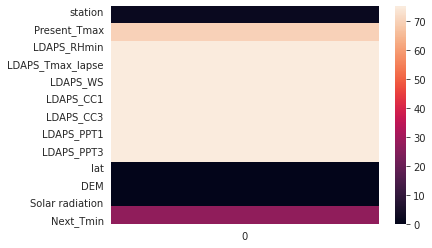

In [ ]:
sns.heatmap(df.isnull().sum().to_frame())

In [ ]:
df.isnull().sum()

station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
dtype: int64

In [ ]:
def rand_emputer(df,feature):
  ind=df.loc[df[feature].isnull()==True].index
  feat=df[feature].loc[df[feature].isnull()==False]
  val=feat.sample(len(ind))
  val.index=ind
  df[feature].loc[df[feature].isnull()]=val

In [ ]:
for i in ['Present_Tmax','Present_Tmin','LDAPS_RHmin','LDAPS_RHmax','LDAPS_Tmax_lapse','LDAPS_Tmin_lapse','LDAPS_WS','LDAPS_LH','LDAPS_CC1','LDAPS_CC2','LDAPS_CC3','LDAPS_CC4','LDAPS_PPT1','LDAPS_PPT2','LDAPS_PPT3','LDAPS_PPT4']:
  rand_emputer(df,i)

**We observe 2 missing values,I can directly drop these,as these are very less.**

In [ ]:
df.dropna(inplace=True)

##**Changing Data type**

In [ ]:
import datetime as dt

In [ ]:
df['Date']=pd.to_datetime(df['Date'])

## Data filtering:-

In [ ]:
df.head()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,2013-06-30,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,0.0,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,2013-06-30,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,0.159444,0.127727,0.0,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5
2,3.0,2013-06-30,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,0.204091,0.142125,0.0,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9
3,4.0,2013-06-30,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,0.161157,0.134249,0.0,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3
4,5.0,2013-06-30,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,0.178892,0.170021,0.0,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5


## Analysing feature

In [ ]:
df.nunique()

station               25
Date                 310
Present_Tmax         167
Present_Tmin         155
LDAPS_RHmin         7645
LDAPS_RHmax         7637
LDAPS_Tmax_lapse    7648
LDAPS_Tmin_lapse    7648
LDAPS_WS            7648
LDAPS_LH            7648
LDAPS_CC1           7543
LDAPS_CC2           7555
LDAPS_CC3           7572
LDAPS_CC4           7497
LDAPS_PPT1          2798
LDAPS_PPT2          2498
LDAPS_PPT3          2345
LDAPS_PPT4          1912
lat                   12
lon                   25
DEM                   25
Slope                 25
Solar radiation     1575
Next_Tmax            183
Next_Tmin            157
dtype: int64

In [ ]:
#df['delta_max']=df['Next_Tmax']-df['Present_Tmax']
#df['delta_min']=df['Next_Tmin']-df['Present_Tmin']



---


## **Visualization and feature eng**


---



---



lat

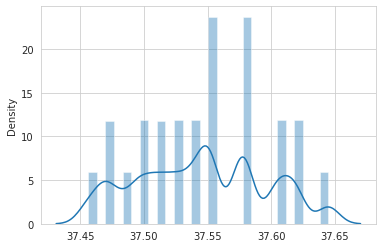

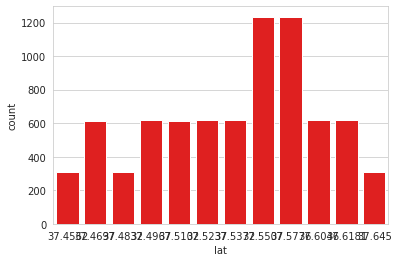

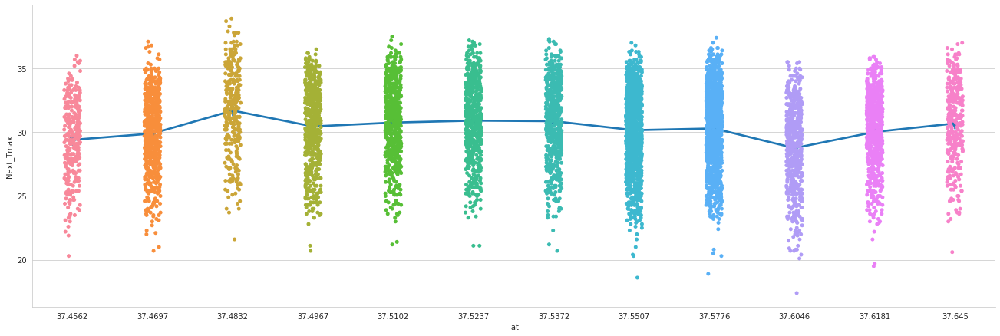

In [ ]:
sns.distplot(x=df['lat'])
plt.show()
sns.countplot(x='lat',data=df,color='r')
plt.show()

sns.catplot(x='lat',y='Next_Tmax',height=6,aspect= 3,data=df)
sns.pointplot(x='lat',y='Next_Tmax',height=6,aspect= 3,data=df)

lattitude has no linear relation with temp

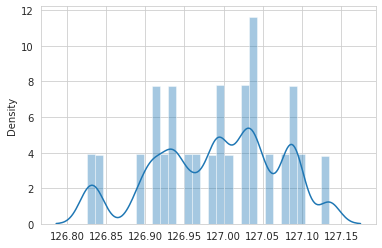

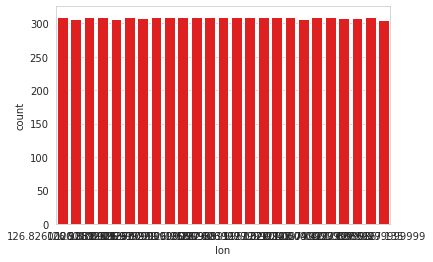

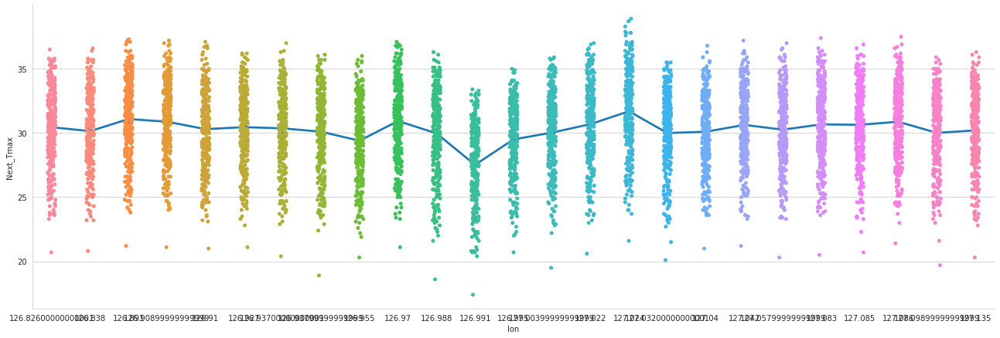

In [ ]:
sns.distplot(x=df['lon'])
plt.show()
sns.countplot(x='lon',data=df,color='r')
plt.show()

sns.catplot(x='lon',y='Next_Tmax',height=6,aspect= 3,data=df)
sns.pointplot(x='lon',y='Next_Tmax',height=6,aspect= 3,data=df)

lattitude has no linear relation with temp

Solar radiation

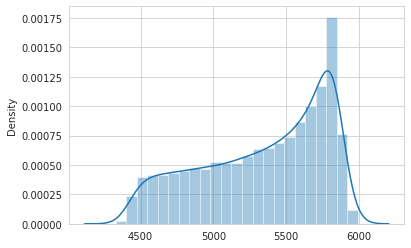

In [ ]:
sns.distplot(x=df['Solar radiation'])

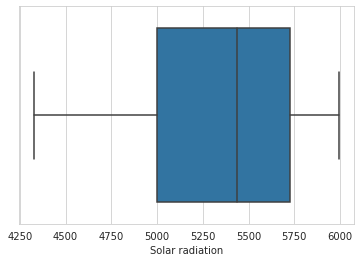

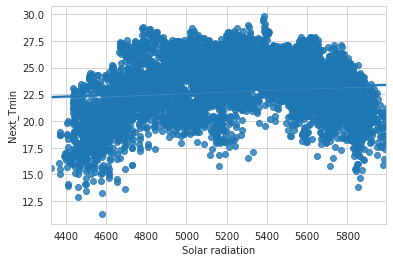

In [ ]:
sns.boxplot(x='Solar radiation',data=df)
plt.show()
sns.regplot(x='Solar radiation',y='Next_Tmin',data=df)

Solar radiation is a left skewed data set with no outliers and relation with output



---



---


Slope

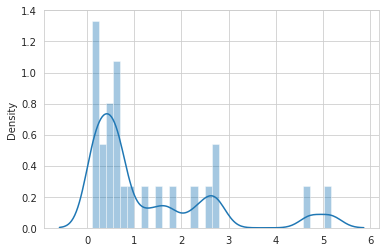

In [ ]:
sns.distplot(x=df['Slope'])

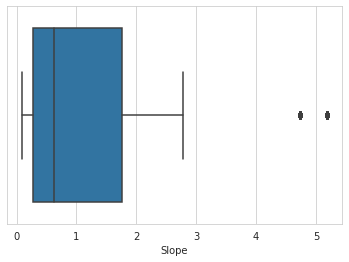

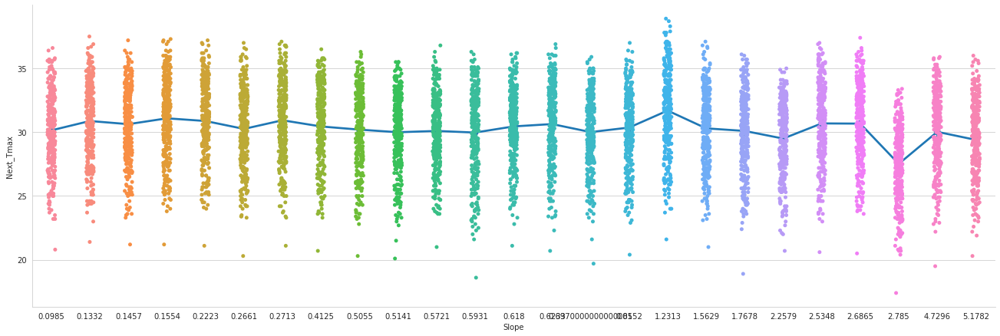

In [ ]:
sns.boxplot(x='Slope',data=df)
plt.show()
sns.catplot(x='Slope',y='Next_Tmax',height=6,aspect= 3,data=df)
sns.pointplot(x='Slope',y='Next_Tmax',height=6,aspect= 3,data=df)

slope is a right skewed data set with no outliers and relation with output



---

DEM

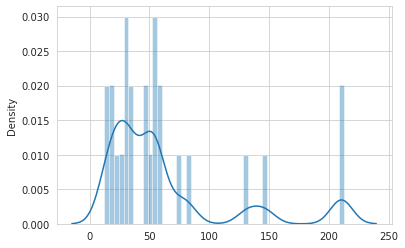

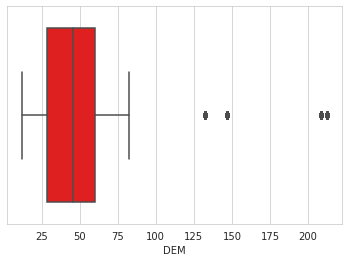

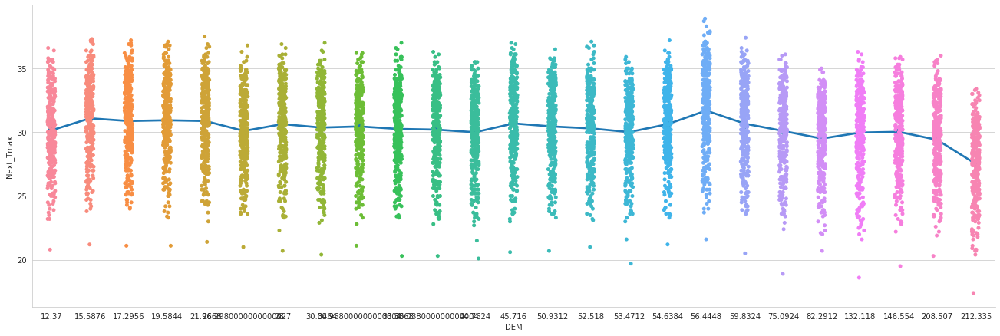

In [ ]:
sns.distplot(x=df['DEM'])
plt.show()
sns.boxplot(x='DEM',data=df,color='r')
plt.show()
sns.catplot(x='DEM',y='Next_Tmax',height=6,aspect= 3,data=df)
sns.pointplot(x='DEM',y='Next_Tmax',height=6,aspect= 3,data=df)

Extremly high DEM has low temp

station

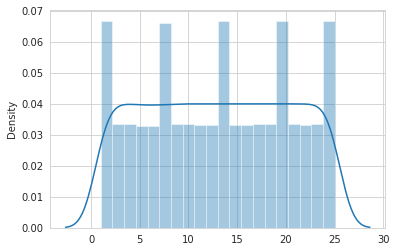

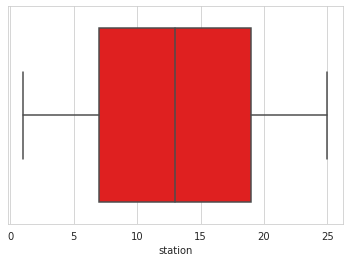

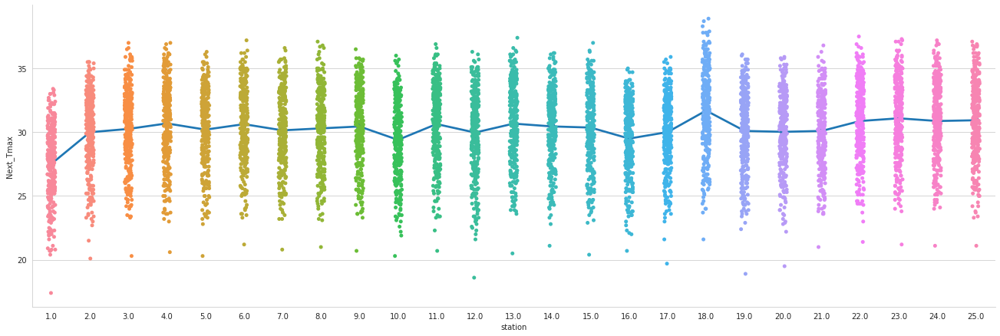

In [ ]:
sns.distplot(x=df['station'])
plt.show()
sns.boxplot(x='station',data=df,color='r')
plt.show()

sns.catplot(x='station',y='Next_Tmax',height=6,aspect= 3,data=df)
sns.pointplot(x='station',y='Next_Tmax',height=6,aspect= 3,data=df)

Max station has the same temparure variation but some station are having slightly lower or alighty higher temprature

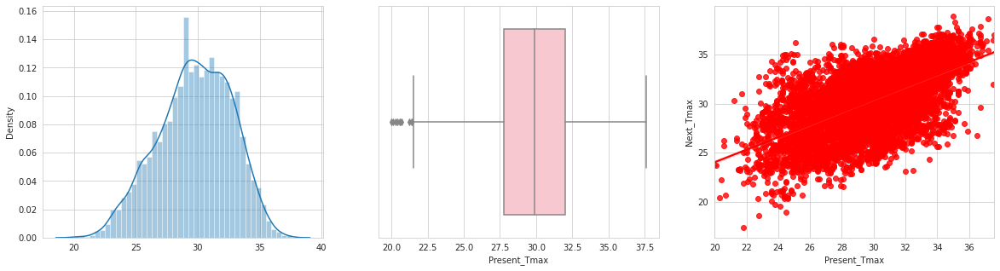

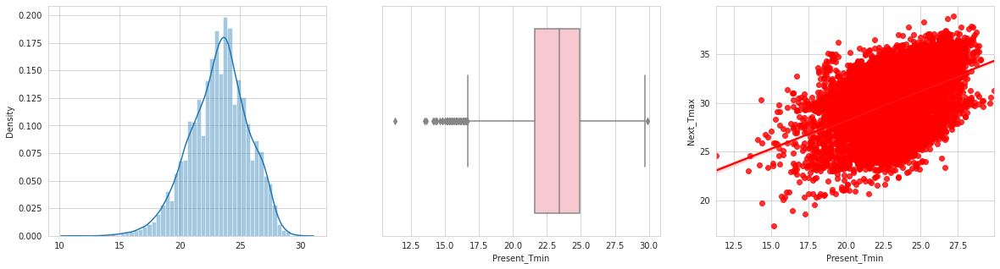

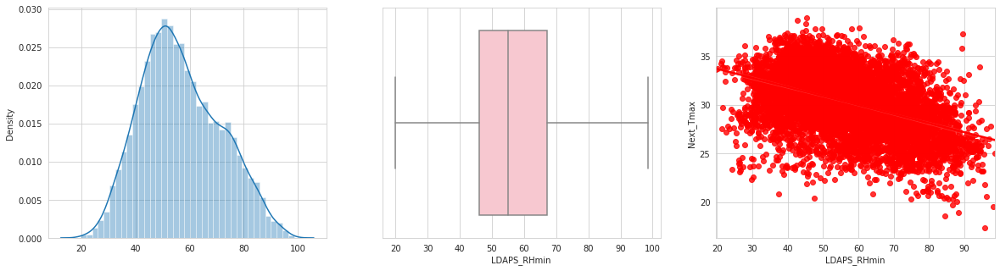

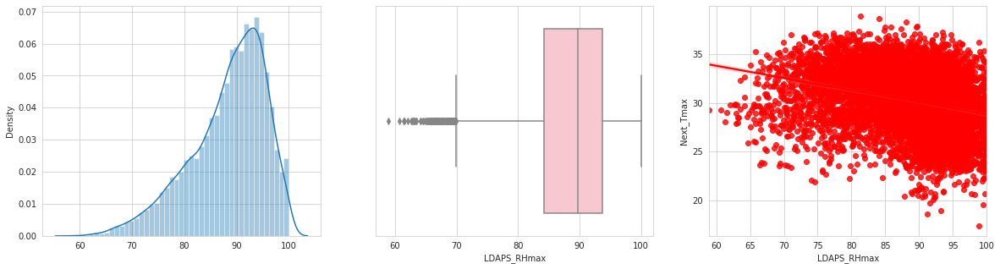

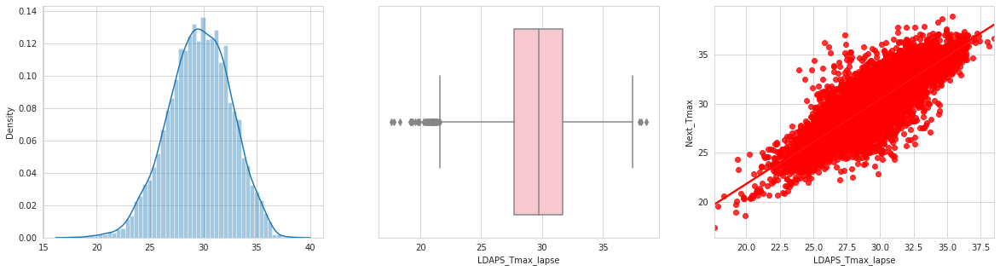

...

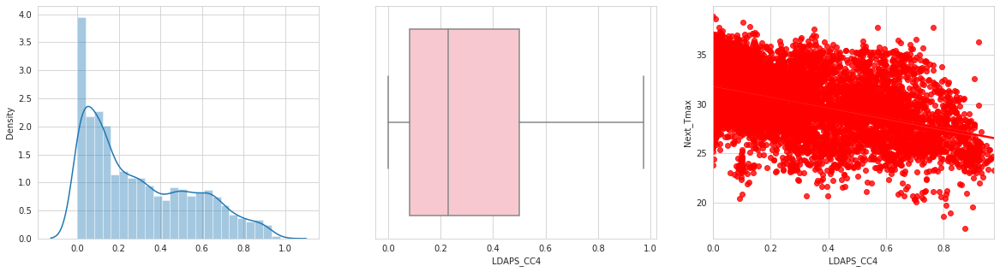

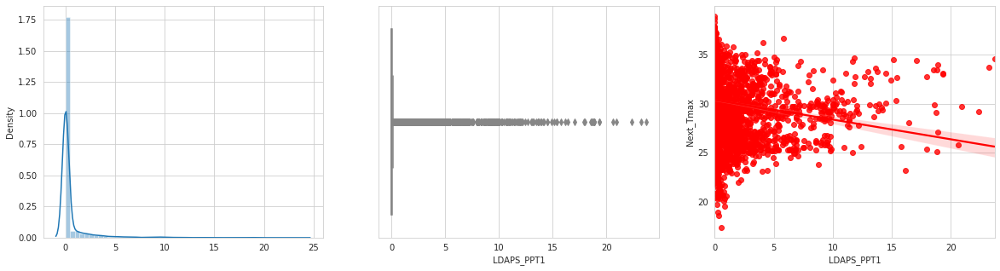

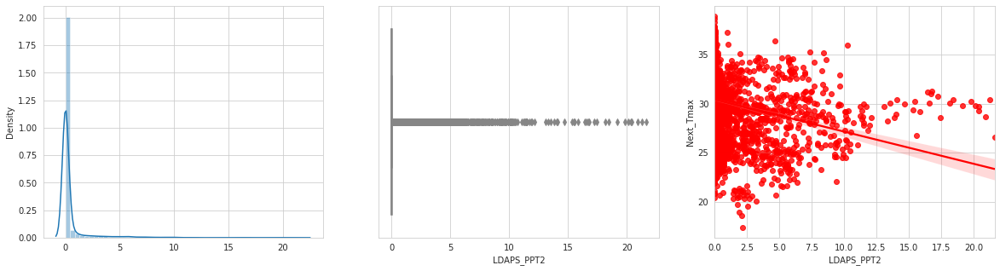

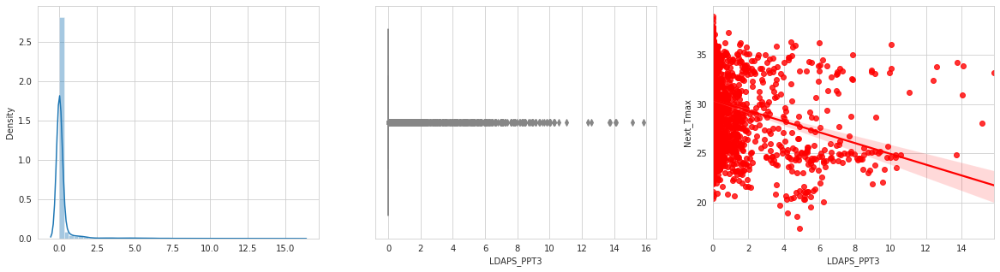

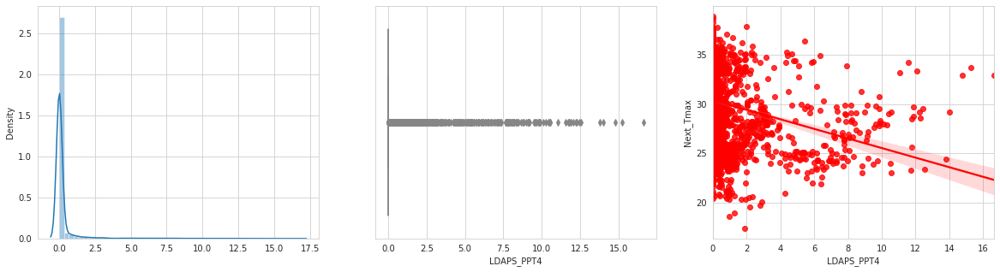

In [ ]:
for i in ['Present_Tmax','Present_Tmin','LDAPS_RHmin','LDAPS_RHmax','LDAPS_Tmax_lapse','LDAPS_Tmin_lapse','LDAPS_WS','LDAPS_LH','LDAPS_CC1','LDAPS_CC2','LDAPS_CC3','LDAPS_CC4','LDAPS_PPT1','LDAPS_PPT2','LDAPS_PPT3','LDAPS_PPT4']:
  fig1, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(20,5))
  sns.distplot(x=df[i],ax=ax1)
  sns.boxplot(x=i,data=df,color='pink',ax=ax2)
  sns.regplot(x=i,y='Next_Tmax',data=df,color='r',ax=ax3)
  plt.show()



---



---


Present day Maximum temperature is directly proportional to next day maximum  temperature.

Ldps_rh,Ldps_ws,Ldps_cc,ldps_ppt is inversely proportional to next day temperature .

Ldps_t is Directly proportional to next day temperature

Ldps_ppt Right skewed with high Outliers

Ldps_cc Right skewed with no Outliers 


---



---



In [ ]:
df.head()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,2013-06-30,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,0.0,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,2013-06-30,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,0.159444,0.127727,0.0,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5
2,3.0,2013-06-30,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,0.204091,0.142125,0.0,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9
3,4.0,2013-06-30,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,0.161157,0.134249,0.0,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3
4,5.0,2013-06-30,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,0.178892,0.170021,0.0,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5


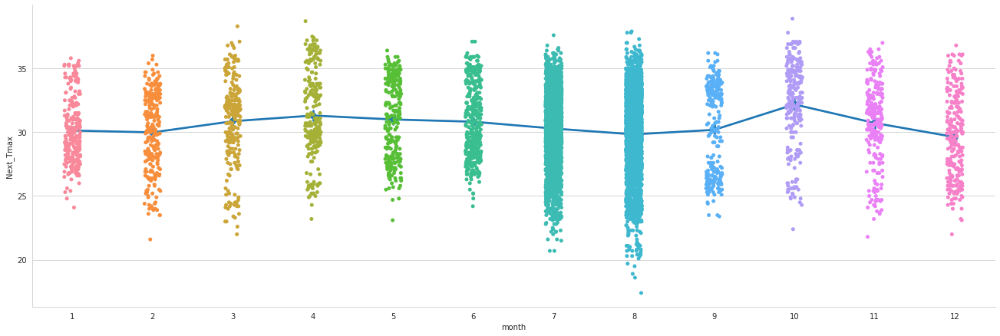

In [ ]:
import datetime as dt
df['month']=pd.to_datetime(df['Date']).dt.month

sns.catplot(x='month',y='Next_Tmax',height=6,aspect= 3,data=df)
sns.pointplot(x='month',y='Next_Tmax',height=6,aspect= 3,data=df) 

month has some variance with temp


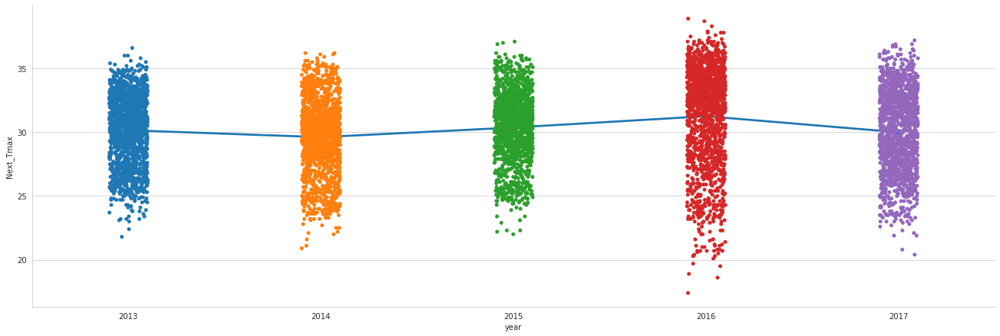

In [ ]:
import datetime as dt
df['year']=pd.to_datetime(df['Date']).dt.year

sns.catplot(x='year',y='Next_Tmax',height=6,aspect= 3,data=df)
sns.pointplot(x='year',y='Next_Tmax',height=6,aspect= 3,data=df) 

No varince with respect to temp

In [ ]:
df.drop(['year'],axis=1,inplace=True)

In [ ]:
df.drop(['Date'],axis=1,inplace=True)

In [ ]:
from sklearn.preprocessing import power_transform as PT
pt=pd.DataFrame()
for i in ['Present_Tmax','Present_Tmin','LDAPS_RHmin','LDAPS_RHmax','LDAPS_Tmax_lapse','LDAPS_Tmin_lapse','LDAPS_WS','LDAPS_LH','LDAPS_CC1','LDAPS_CC2','LDAPS_CC3','LDAPS_CC4','LDAPS_PPT1','LDAPS_PPT2','LDAPS_PPT3','LDAPS_PPT4']:
  if df[i].min()<=0:
    pt1=(df[i]-df[i].min()+0.0001)
  else:
    pt1=df[i]
  pt=pd.concat([pt,pd.DataFrame(pt1)],axis=1)

pt1=PT(pt)
pt1=pd.DataFrame(pt1,columns=['Present_Tmax','Present_Tmin','LDAPS_RHmin','LDAPS_RHmax','LDAPS_Tmax_lapse','LDAPS_Tmin_lapse','LDAPS_WS','LDAPS_LH','LDAPS_CC1','LDAPS_CC2','LDAPS_CC3','LDAPS_CC4','LDAPS_PPT1','LDAPS_PPT2','LDAPS_PPT3','LDAPS_PPT4'])


In [ ]:
def pplot(df,i):
  plt.figure(figsize=(20,5))
  plt.subplot(1,3,1)
  
  sns.histplot(x=i,data=df,kde=True)
  plt.subplot(1,3,2)
  stat.probplot(df[i],dist='norm',plot=pylab)
  plt.subplot(1,3,3)
  sns.boxplot(y=i,data=df)
  plt.show()

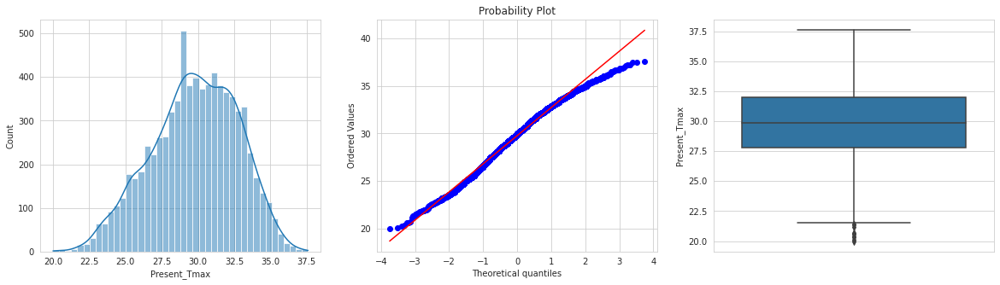

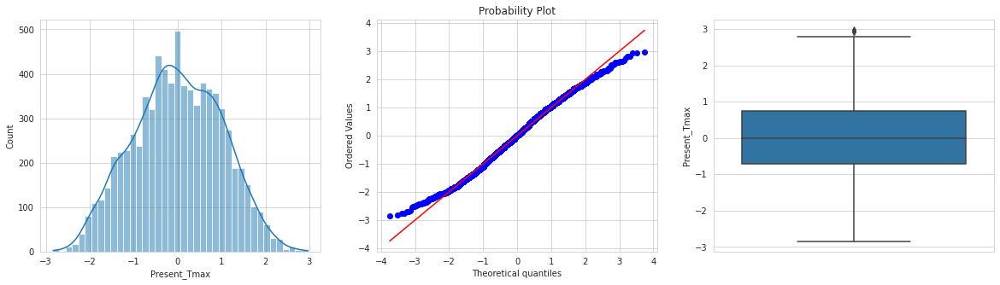

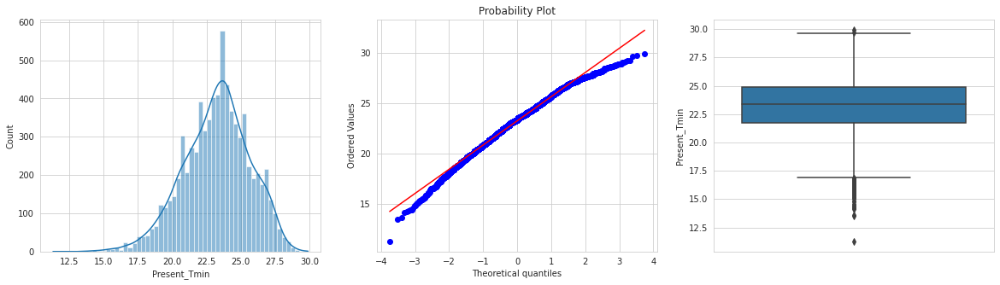

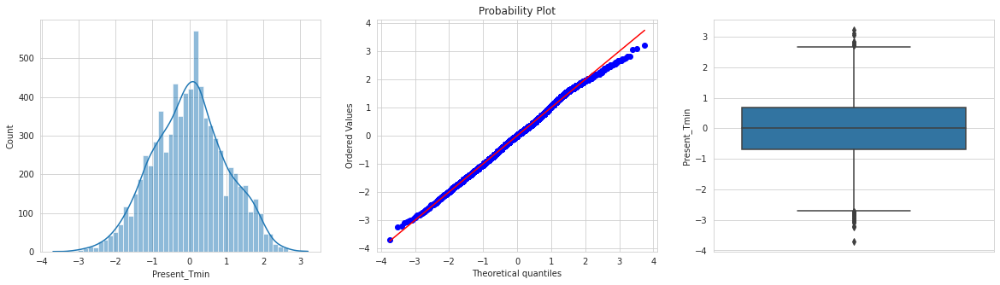

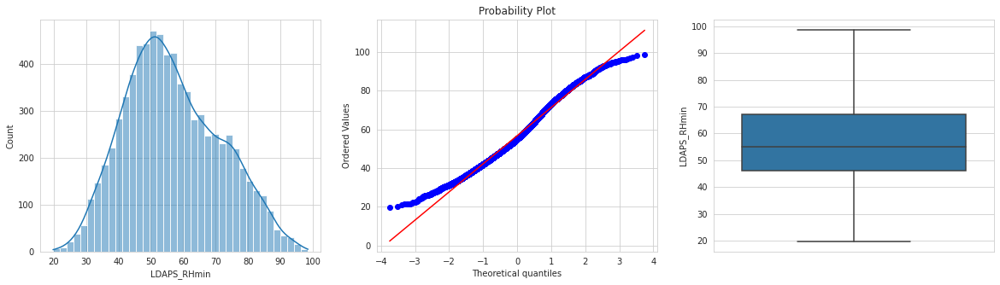

...

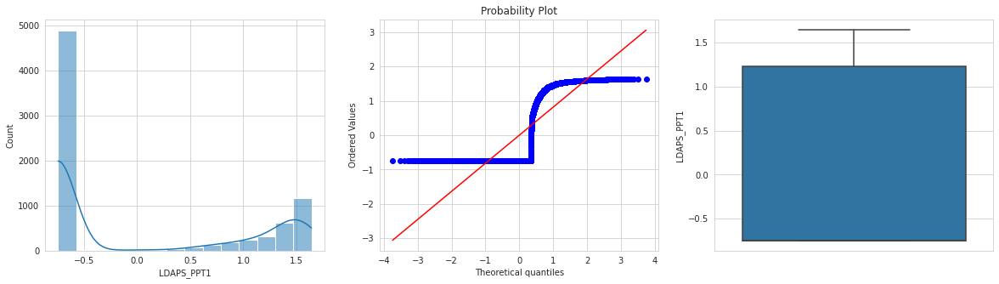

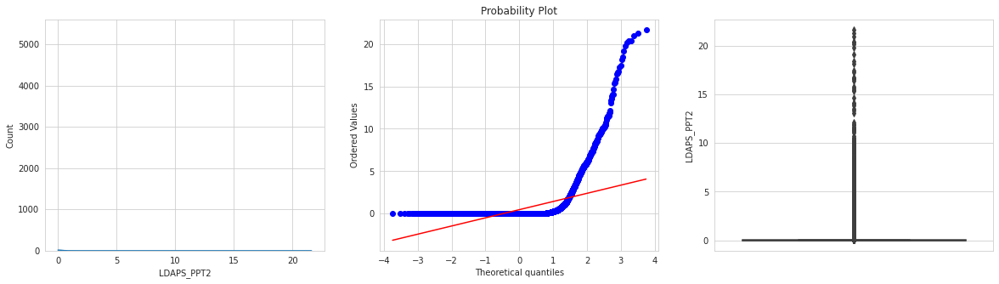

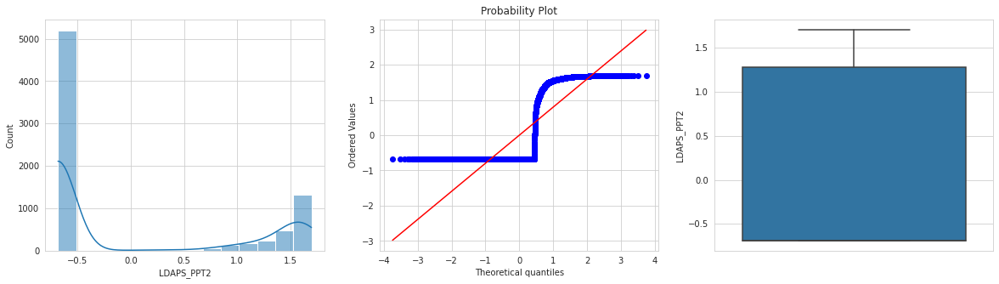

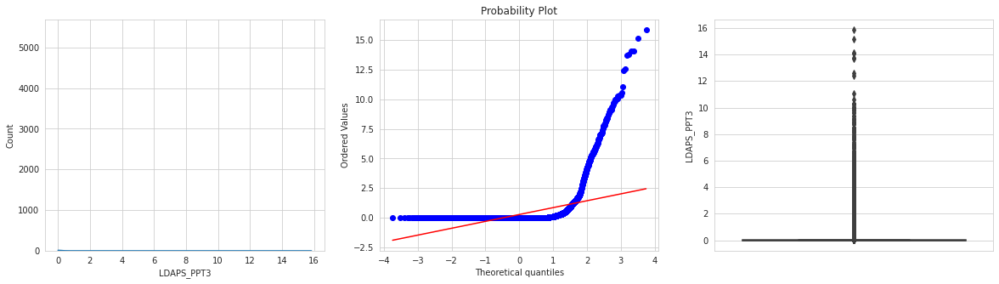

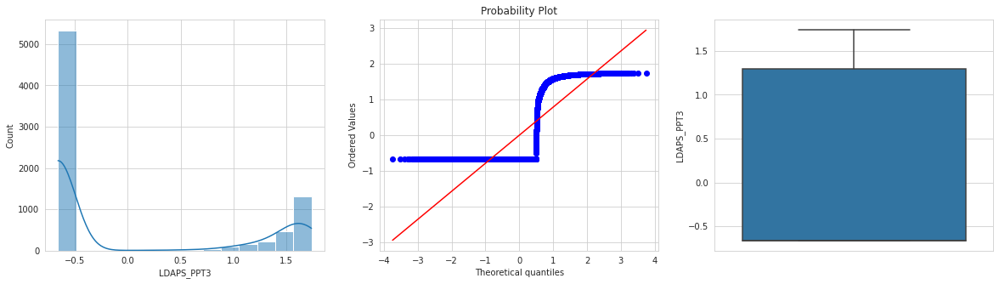

In [ ]:
import scipy.stats as stat
import pylab 
for i in ['Present_Tmax','Present_Tmin','LDAPS_RHmin','LDAPS_RHmax','LDAPS_Tmax_lapse','LDAPS_Tmin_lapse','LDAPS_WS','LDAPS_LH','LDAPS_CC1','LDAPS_CC2','LDAPS_CC3','LDAPS_CC4','LDAPS_PPT1','LDAPS_PPT2','LDAPS_PPT3','LDAPS_PPT4']:
  pplot(df,i)
  pplot(pt1,i)

after transformation price and duration are almost normaly distributed  and outlier has been minimized 

In [ ]:
df.index=range(7723)

In [ ]:
pt2=pd.concat([df.drop(['Present_Tmax','Present_Tmin','LDAPS_RHmin','LDAPS_RHmax','LDAPS_Tmax_lapse','LDAPS_Tmin_lapse','LDAPS_WS','LDAPS_LH','LDAPS_CC1','LDAPS_CC2','LDAPS_CC3','LDAPS_CC4','LDAPS_PPT1','LDAPS_PPT2','LDAPS_PPT3','LDAPS_PPT4'],axis=1),pt1],axis=1)

In [190]:
x=pt2.drop(['Next_Tmax','Next_Tmin'],axis=1)
y1=pt2['Next_Tmax']
y2=pt2['Next_Tmin']

In [191]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=6)
kmeans.fit(x)
pt2["Cluster"] = kmeans.predict(x)
pt2["Cluster"] = pt1["Cluster"].astype("float")

pt2.Cluster

0       0.0
1       0.0
2       0.0
3       0.0
4       0.0
       ... 
7718    3.0
7719    3.0
7720    3.0
7721    3.0
7722    3.0
Name: Cluster, Length: 7723, dtype: float64

In [192]:
x=pt2.drop(['Next_Tmax','Next_Tmin'],axis=1)
y1=pt2['Next_Tmax']
y2=pt2['Next_Tmin']

In [ ]:
pt2.head()

,station,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,month,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,Cluster
0,1.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2,6,-0.409936,-0.793530,0.172834,0.272425,-0.556655,-0.312057,0.095182,0.347545,-0.300849,-0.376316,-0.398156,-0.402133,-0.744315,-0.685291,-0.657396,-0.573218,0.0
1,2.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5,6,0.700742,-0.716082,-0.239837,0.185797,0.042188,0.143192,-0.618505,-0.176983,-0.337368,-0.171263,-0.409755,-0.419939,-0.744315,-0.685291,-0.657396,-0.573218,0.0
2,3.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9,6,0.591644,-0.025588,-0.498656,-0.768291,0.125393,0.392552,-0.309531,-1.416776,-0.409298,-0.148215,-0.194868,-0.341854,-0.744315,-0.685291,-0.657396,-0.573218,0.0
3,4.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3,6,0.737337,0.016829,0.171772,1.310916,-0.008079,-0.174572,-0.649563,0.242556,-0.377690,-0.278928,-0.400925,-0.383941,-0.744315,-0.685291,-0.657396,-0.573218,0.0
4,5.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5,6,0.519483,-0.598418,0.032306,0.111327,-0.209484,-0.104226,-0.586900,1.286501,-0.693548,-0.178501,-0.312469,-0.203275,-0.744315,-0.685291,-0.657396,-0.573218,0.0


## **Correlation**

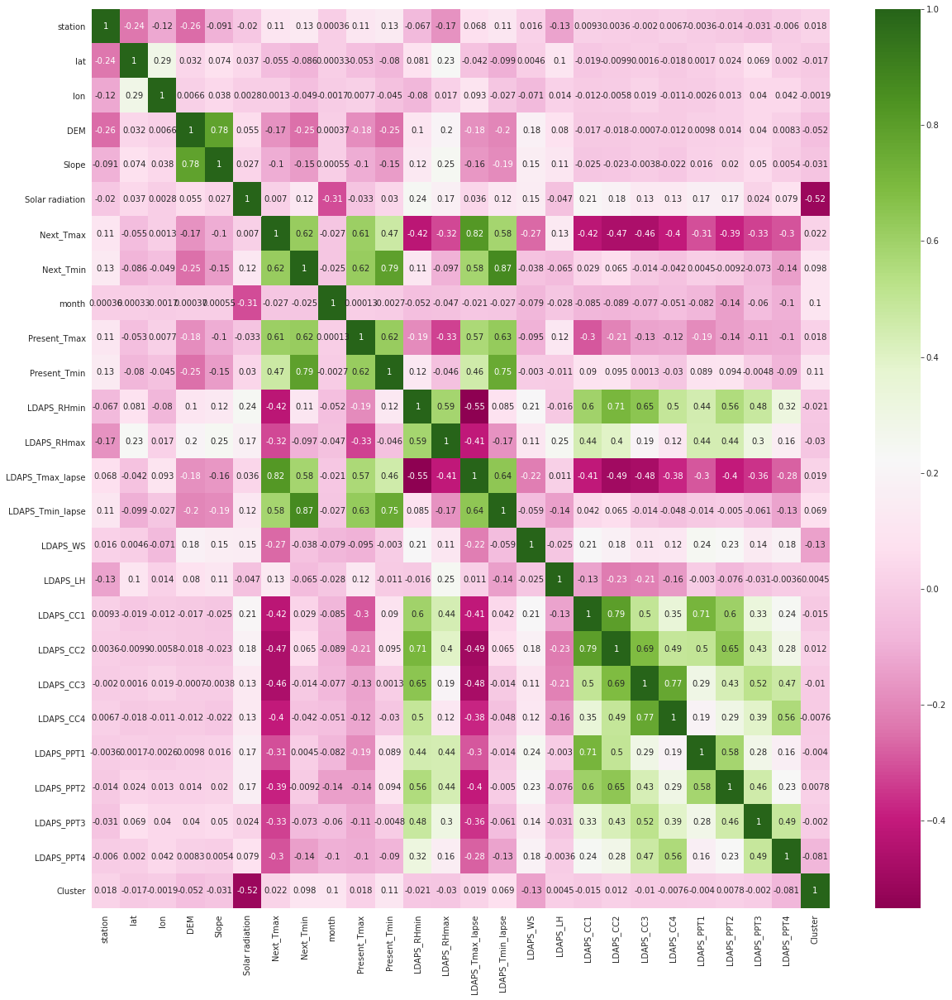

In [ ]:
plt.figure(figsize=(20,20))
sns.heatmap(pt2.corr(),cmap='PiYG',annot=True)

Multicolinearity exists

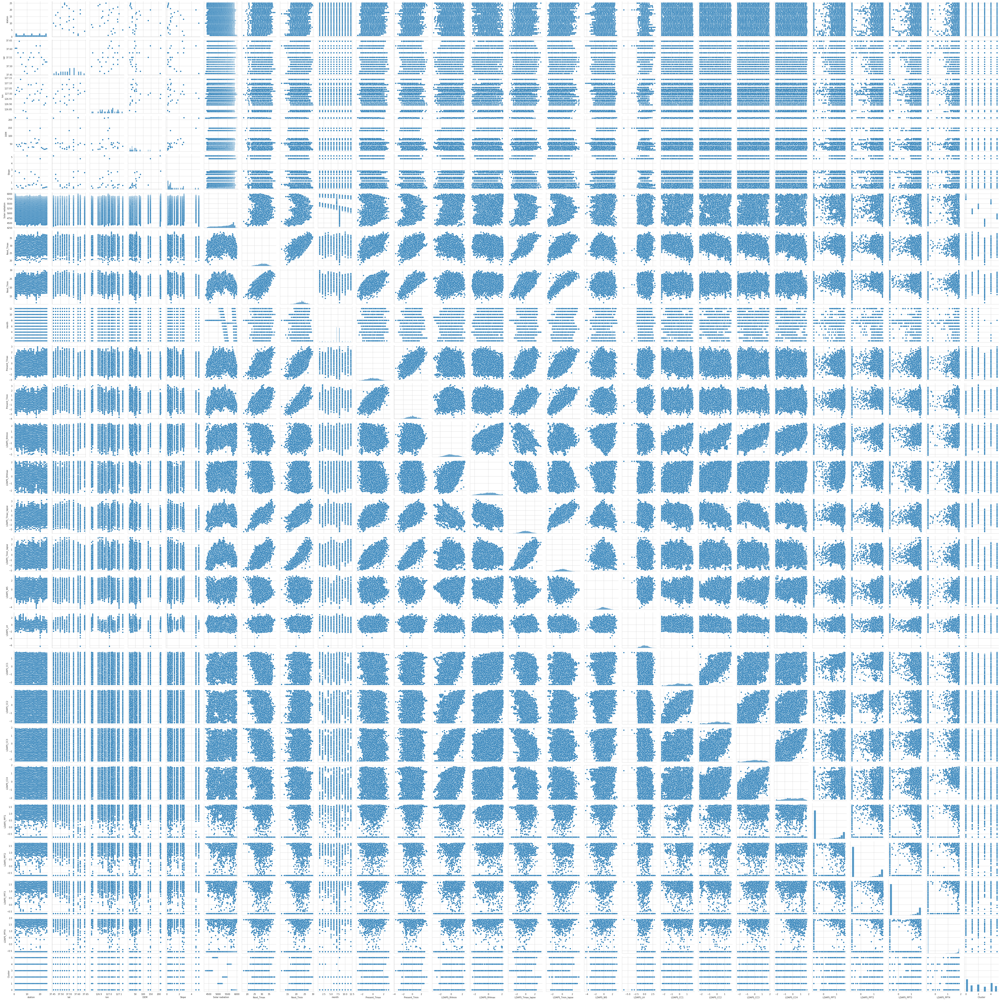

In [ ]:
sns.pairplot(pt2)

In [152]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif as anova
s = SelectKBest(anova, k=10)
s.fit(x,y1)
pd.DataFrame([s.scores_,s.pvalues_],columns=x.columns).T.sort_values(by=0)

,0,1
lon,0.950981,6.686388e-01
lat,1.028247,3.830970e-01
Cluster,1.277903,7.390330e-03
month,1.380595,6.061137e-04
Slope,1.421196,1.996143e-04
station,1.539991,5.421234e-06
LDAPS_LH,1.833900,1.075989e-10
Solar radiation,1.853281,4.862642e-11
DEM,2.621891,4.149056e-27
LDAPS_WS,5.038568,3.210093e-91


As discused Latitude and logitude are not related to o/p as per dataset

## **Separating dependent and independent variables**

In [154]:
x.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7723 entries, 0 to 7722
Data columns (total 24 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   station           7723 non-null   float64
 1   lat               7723 non-null   float64
 2   lon               7723 non-null   float64
 3   DEM               7723 non-null   float64
 4   Slope             7723 non-null   float64
 5   Solar radiation   7723 non-null   float64
 6   month             7723 non-null   int64  
 7   Present_Tmax      7723 non-null   float64
 8   Present_Tmin      7723 non-null   float64
 9   LDAPS_RHmin       7723 non-null   float64
 10  LDAPS_RHmax       7723 non-null   float64
 11  LDAPS_Tmax_lapse  7723 non-null   float64
 12  LDAPS_Tmin_lapse  7723 non-null   float64
 13  LDAPS_WS          7723 non-null   float64
 14  LDAPS_LH          7723 non-null   float64
 15  LDAPS_CC1         7723 non-null   float64
 16  LDAPS_CC2         7723 non-null   float64


In [155]:
from sklearn.model_selection import train_test_split as TTS
x_train1,x_test1,y_train1,y_test1=TTS(x,y1,test_size=0.3,random_state=42)
x_train2,x_test2,y_train2,y_test2=TTS(x,y2,test_size=0.3,random_state=42)

In [156]:
from sklearn.preprocessing import StandardScaler as SS
ss=SS()
x_train_scaler1=ss.fit_transform(x_train1)
x_test_scaler1= ss.transform(x_test1)

x_train_scaler2=ss.fit_transform(x_train2)
x_test_scaler2= ss.transform(x_test2)

In [188]:
from sklearn.preprocessing import StandardScaler as SS
ss=SS()
x_train_scaler1=ss.fit_transform(x_train1)
x_test_scaler1= ss.transform(x_test1)

x_train_scaler2=ss.fit_transform(x_train2)
x_test_scaler2= ss.transform(x_test2)



---
## Adding variable using classification 


In [212]:
y_avg=pt2['Next_Tmax']
k=y_avg.std()+y_avg.mean()
l=[]
for i in pt1.index:
  if pt2['Next_Tmax'][i]>k:
    l.append(2)
  elif pt2['Next_Tmax'][i]>y_avg.mean()-y_avg.std():
    l.append(1)
  else:
    l.append(0)

In [235]:
y=pd.Series(l)
from sklearn.model_selection import train_test_split as TTS
x_train,x_test,y_train,y_test=TTS(x,y,test_size=0.1,random_state=42)

from sklearn.preprocessing import StandardScaler as SS
ss=SS()
x_train_scaler=ss.fit_transform(x_train)
x_test_scaler= ss.transform(x_test)

In [238]:
from sklearn.linear_model import LogisticRegression
clf_lr = LogisticRegression(random_state=0).fit(x_train_scaler, y_train)
y_pred=clf_lr.predict(ss.transform(x))
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report
print(confusion_matrix(y,y_pred))
print(accuracy_score(y,y_pred))
print(classification_report(y,y_pred))

[[ 893  438    0]
 [ 235 4640  211]
 [   2  452  852]]
0.8267512624627735
              precision    recall  f1-score   support

           0       0.79      0.67      0.73      1331
           1       0.84      0.91      0.87      5086
           2       0.80      0.65      0.72      1306

    accuracy                           0.83      7723
   macro avg       0.81      0.75      0.77      7723
weighted avg       0.82      0.83      0.82      7723



In [240]:
x['y_cl']=y_pred

In [274]:
y_avg=pt2['Next_Tmin']
k=y_avg.std()+y_avg.mean()
l=[]
for i in pt1.index:
  if pt2['Next_Tmin'][i]>k:
    l.append(2)
  elif pt2['Next_Tmin'][i]>y_avg.mean()-y_avg.std():
    l.append(1)
  else:
    l.append(0)

In [275]:
y=pd.Series(l)
from sklearn.model_selection import train_test_split as TTS
x_train,x_test,y_train,y_test=TTS(x,y,test_size=0.1,random_state=42)

from sklearn.preprocessing import StandardScaler as SS
ss=SS()
x_train_scaler=ss.fit_transform(x_train)
x_test_scaler= ss.transform(x_test)

In [276]:
from sklearn.linear_model import LogisticRegression
clf_lr = LogisticRegression(random_state=0).fit(x_train_scaler, y_train)
y_pred=clf_lr.predict(ss.transform(x))
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report
print(confusion_matrix(y,y_pred))
print(accuracy_score(y,y_pred))
print(classification_report(y,y_pred))

[[ 858  345    0]
 [ 227 4878  222]
 [   0  319  874]]
0.8558850187750874
              precision    recall  f1-score   support

           0       0.79      0.71      0.75      1203
           1       0.88      0.92      0.90      5327
           2       0.80      0.73      0.76      1193

    accuracy                           0.86      7723
   macro avg       0.82      0.79      0.80      7723
weighted avg       0.85      0.86      0.85      7723



In [277]:
x['y_cl1']=y_pred

In [281]:
from sklearn.model_selection import train_test_split as TTS
x_train1,x_test1,y_train1,y_test1=TTS(x,y1,test_size=0.3,random_state=42)
x_train2,x_test2,y_train2,y_test2=TTS(x,y2,test_size=0.3,random_state=42)

In [282]:
from sklearn.preprocessing import StandardScaler as SS
ss=SS()
x_train_scaler1=ss.fit_transform(x_train1)
x_test_scaler1= ss.transform(x_test1)

x_train_scaler2=ss.fit_transform(x_train2)
x_test_scaler2= ss.transform(x_test2)

# **Model Evaluation1**

## **Linear Regression**



In [283]:
from sklearn.linear_model import LinearRegression as lr
reg_lr = lr(normalize=True).fit(x_train_scaler1,y_train1)
y_pred=reg_lr.predict(x_test_scaler1)
from sklearn.metrics import mean_absolute_error as rms, r2_score
print(r2_score(y_test1,y_pred))
print(rms(y_test1,y_pred))
lr_e=r2_score(y_test1,y_pred)

0.7635779419654842
1.1460628729979028


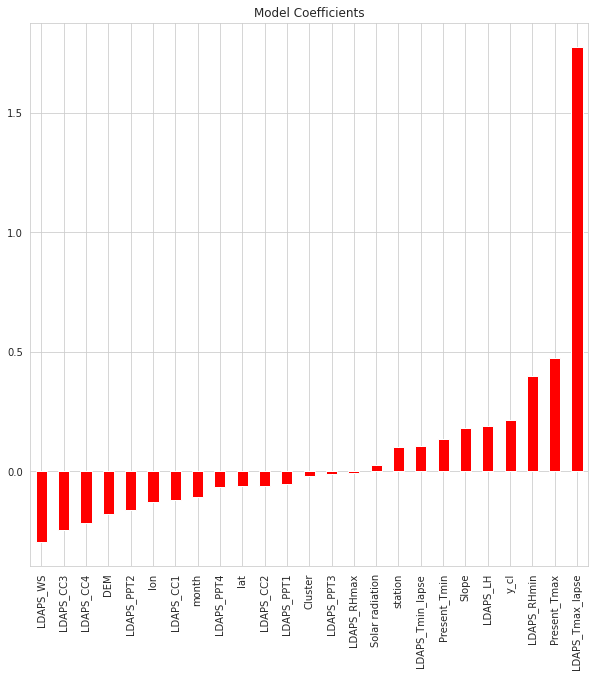

In [245]:
coef = pd.Series(reg_lr.coef_, x.columns).sort_values()
plt.figure(figsize=(10,10))
coef.plot(kind='bar', title="Model Coefficients" , color = 'red')

In [246]:
from sklearn.model_selection import cross_validate
cv_results = cross_validate(lr(normalize=True), ss.transform(x), y1, cv=3,scoring='r2')

lr_reg=cv_results['test_score'].mean()

In [247]:
lr_reg

0.7079611532765816

## **Ridge**

In [248]:
from sklearn.linear_model import Ridge
reg_lr = Ridge().fit(X=x_train_scaler1,y=y_train1)
y_pred=reg_lr.predict(x_test_scaler1)
from sklearn.metrics import mean_absolute_error as rms, r2_score
print(r2_score(y_test1,y_pred))
print(rms(y_test1,y_pred))
ridge_e=r2_score(y_test1,y_pred)

0.763587457942194
1.1459965015172624


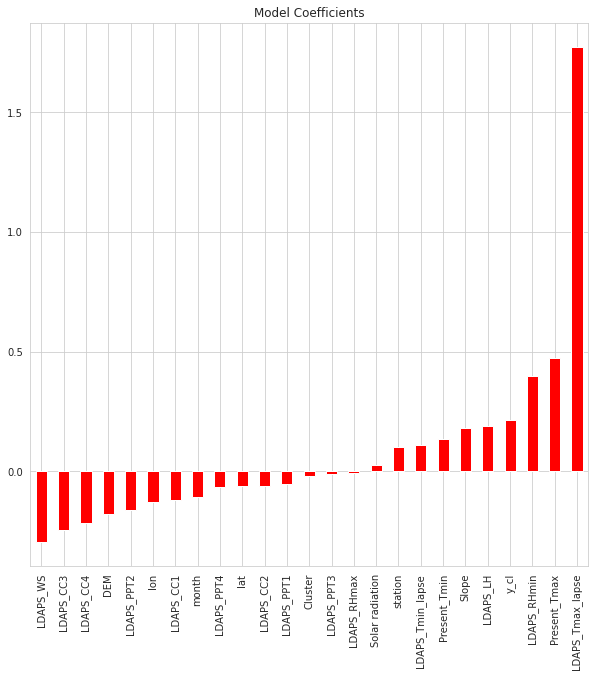

In [249]:
coef = pd.Series(reg_lr.coef_, x.columns).sort_values()
plt.figure(figsize=(10,10))
coef.plot(kind='bar', title="Model Coefficients" , color = 'red')

In [250]:
from sklearn.model_selection import cross_validate
cv_results = cross_validate(Ridge(), ss.transform(x), y1, cv=3)

rid_reg=cv_results['test_score'].mean()

In [251]:
rid_reg

0.7079691511316692

## **Random Forest Regressor**


In [252]:
from sklearn.ensemble import RandomForestRegressor as RFR 
reg_rfc = RFR().fit(x_train1, y=y_train1)
y_pred=reg_rfc.predict(x_test1)
from sklearn.metrics import mean_absolute_error as rms, r2_score
from sklearn.metrics import mean_absolute_error as rms, r2_score
print(r2_score(y_test1,y_pred))
print(rms(y_test1,y_pred))
rfr_e=r2_score(y_test1,y_pred)

0.8911095143693403
0.7485507121277514


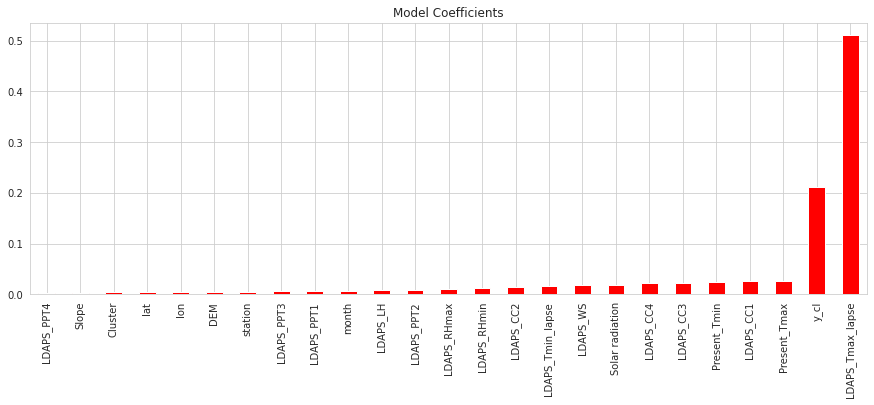

In [253]:
coef = pd.Series(reg_rfc.feature_importances_, x.columns).sort_values()
plt.figure(figsize=(15,5))
coef.plot(kind='bar', title="Model Coefficients" , color = 'red')

In [254]:
from sklearn.model_selection import cross_validate
cv_results = cross_validate(RFR(), x, y1, cv=3)

rfc_score=cv_results['test_score']


In [255]:
rfc_reg=rfc_score.mean()

In [256]:
rfc_reg

0.671372113694527

## **XGB Regressor**

In [257]:
from xgboost import XGBRegressor as XBR
xgr=XBR().fit(x_train1,y_train1)
y_pred = xgr.predict(x_test1)
from sklearn.metrics import mean_absolute_error as rms, r2_score
from sklearn.metrics import mean_absolute_error as rms, r2_score
print(r2_score(y_test1,y_pred))
print(rms(y_test1,y_pred))
xgb_e=r2_score(y_test1,y_pred)

[15:10:23] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.839916868912368
0.943513731942076


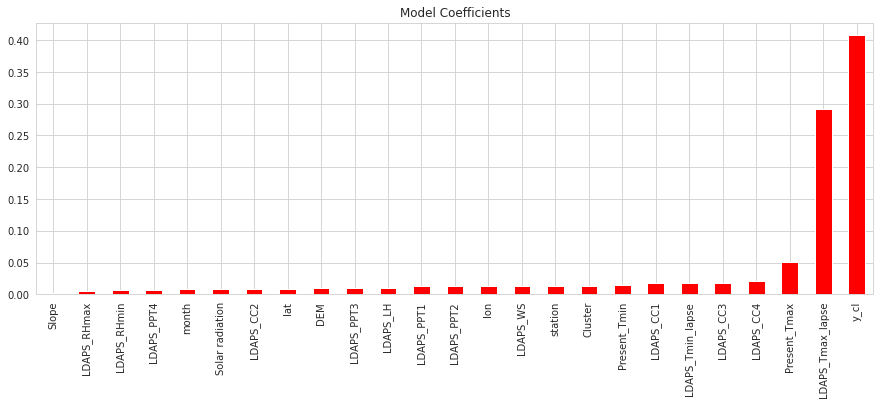

In [258]:
coef = pd.Series(xgr.feature_importances_, x.columns).sort_values()
plt.figure(figsize=(15,5))
coef.plot(kind='bar', title="Model Coefficients" , color = 'red')

In [259]:
from sklearn.model_selection import cross_validate
cv_results = cross_validate(XBR(), x, y1, cv=3)

xgr_score=cv_results['test_score'].mean()




[15:10:24] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[15:10:24] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[15:10:25] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


In [260]:
xgr_score

0.7081797043303478

## **Extra Tree Regressor**

In [261]:
from sklearn.tree import ExtraTreeRegressor as ETR 

etr = ETR()
etr.fit(x_train1, y_train1)
y_pred=etr.predict(x_test1)
from sklearn.metrics import mean_absolute_error as rms, r2_score
print(r2_score(y_test1,y_pred))
print(rms(y_test1,y_pred))
etr_e=r2_score(y_test1,y_pred)

0.7471913379051446
1.1013810962451447


In [262]:
from sklearn.model_selection import cross_validate
cv_results = cross_validate(ETR(), x, y1, cv=3)

etc_score=cv_results['test_score'].mean()


In [263]:
etc_score

0.3192828360499869

## **Support vector Regressor**

In [264]:
from sklearn.svm import SVR

svc = SVR()
svc.fit(x_train_scaler1, y_train1)
y_pred=svc.predict(x_test_scaler1)
from sklearn.metrics import mean_absolute_error as rms, r2_score
print(r2_score(y_test1,y_pred))
print(rms(y_test1,y_pred))
svm_e=r2_score(y_test1,y_pred)

0.8691570605981443
0.8199219597279346


In [265]:
from sklearn.model_selection import cross_validate
cv_results = cross_validate(SVR(kernel='linear'), ss.transform(x), y1, cv=3)

svc_score=cv_results['test_score'].mean()


In [266]:
svc_score

0.7081287697453732

## **Comparing models**

In [267]:
score=[lr_reg,rid_reg,rfc_reg,xgr_score,etc_score,svc_score]
error=[lr_e,ridge_e,rfr_e,xgb_e,etr_e,svm_e]
name=['LR','Ridge','RFC','XGB','ETC','SVC']
diff=[]
for i in range(6):
  diff.append(score[i]-error[i])
pd.DataFrame([name,score,error,diff]).T

,0,1,2,3
0,LR,0.707961,0.763587,-0.0556257
1,Ridge,0.707969,0.763587,-0.0556183
2,RFC,0.671372,0.89111,-0.219737
3,XGB,0.70818,0.839917,-0.131737
4,ETC,0.319283,0.747191,-0.427909
5,SVC,0.708129,0.869157,-0.161028


Ridge is best selected model

# **Model Evaluation2**

## **Linear Regression**



In [285]:
from sklearn.linear_model import LinearRegression as lr
reg_lr = lr(normalize=True).fit(x_train_scaler2,y_train2)
y_pred=reg_lr.predict(x_test_scaler2)
from sklearn.metrics import mean_absolute_error as rms, r2_score
print(r2_score(y_test2,y_pred))
print(rms(y_test2,y_pred))
lr_e=r2_score(y_test2,y_pred)

0.8351398941487285
0.7707802320377647


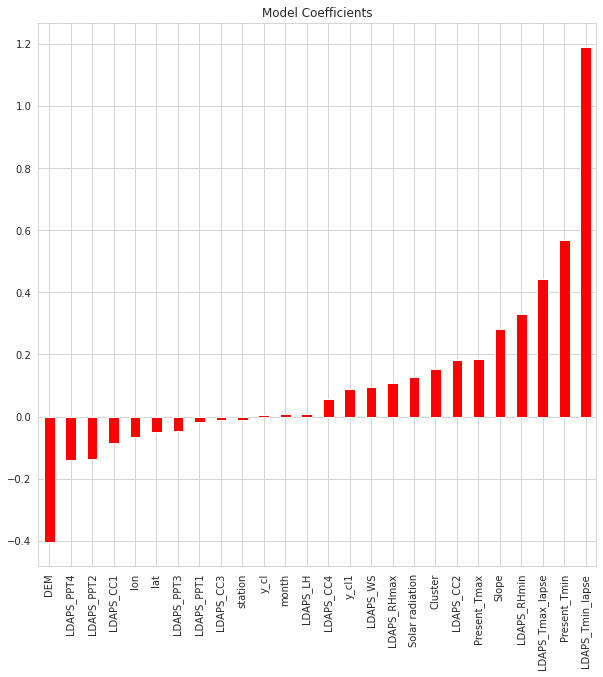

In [286]:
coef = pd.Series(reg_lr.coef_, x.columns).sort_values()
plt.figure(figsize=(10,10))
coef.plot(kind='bar', title="Model Coefficients" , color = 'red')

In [287]:
from sklearn.model_selection import cross_validate
cv_results = cross_validate(lr(normalize=True), ss.transform(x), y2, cv=3,scoring='r2')

lr_reg=cv_results['test_score'].mean()

In [288]:
lr_reg

0.7676523101307188

## **Ridge**

In [290]:
from sklearn.linear_model import Ridge
reg_lr = Ridge().fit(X=x_train_scaler2,y=y_train2)
y_pred=reg_lr.predict(x_test_scaler2)
from sklearn.metrics import mean_absolute_error as rms, r2_score
print(r2_score(y_test2,y_pred))
print(rms(y_test2,y_pred))
ridge_e=r2_score(y_test2,y_pred)

0.835145958715382
0.7707559485658558


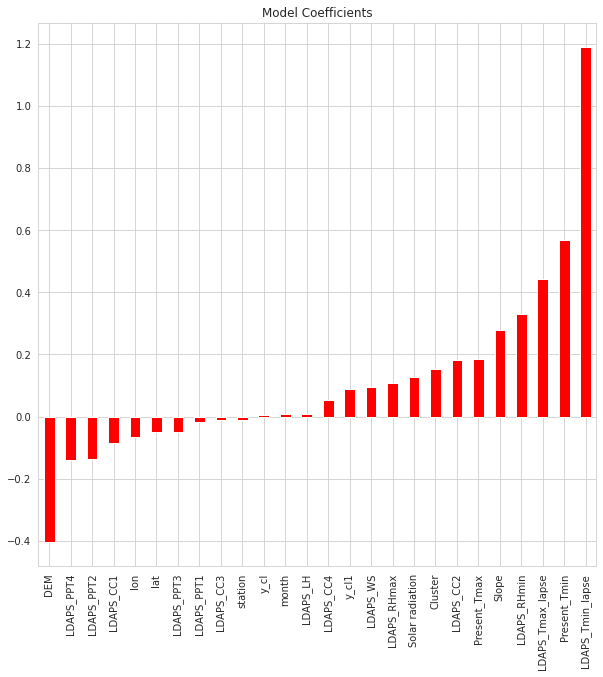

In [291]:
coef = pd.Series(reg_lr.coef_, x.columns).sort_values()
plt.figure(figsize=(10,10))
coef.plot(kind='bar', title="Model Coefficients" , color = 'red')

In [292]:
from sklearn.model_selection import cross_validate
cv_results = cross_validate(Ridge(), ss.transform(x), y2, cv=3)

rid_reg=cv_results['test_score'].mean()

In [293]:
rid_reg

0.7676674504510824

## **Random Forest Regressor**


In [294]:
from sklearn.ensemble import RandomForestRegressor as RFR 
reg_rfc = RFR().fit(x_train2, y=y_train2)
y_pred=reg_rfc.predict(x_test2)
from sklearn.metrics import mean_absolute_error as rms, r2_score
from sklearn.metrics import mean_absolute_error as rms, r2_score
print(r2_score(y_test2,y_pred))
print(rms(y_test2,y_pred))
rfr_e=r2_score(y_test2,y_pred)

0.8977794418129031
0.5886616314199397


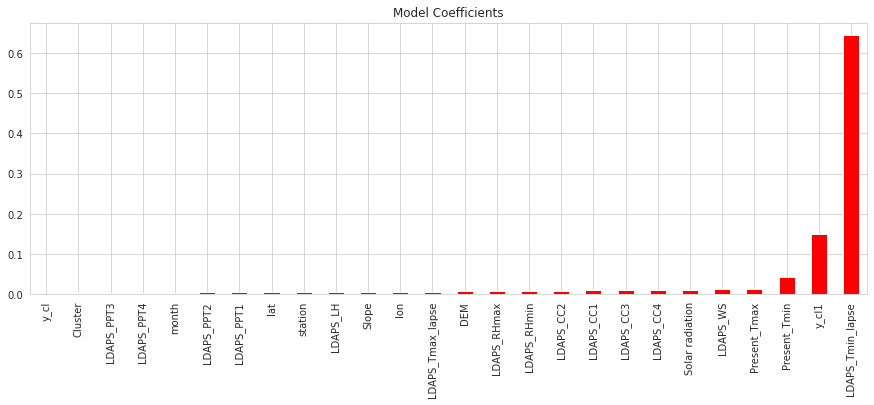

In [295]:
coef = pd.Series(reg_rfc.feature_importances_, x.columns).sort_values()
plt.figure(figsize=(15,5))
coef.plot(kind='bar', title="Model Coefficients" , color = 'red')

In [296]:
from sklearn.model_selection import cross_validate
cv_results = cross_validate(RFR(), x, y2, cv=3)

rfc_score=cv_results['test_score']


In [297]:
rfc_reg=rfc_score.mean()

In [298]:
rfc_reg

0.7530123248390724

## **XGB Regressor**

In [299]:
from xgboost import XGBRegressor as XBR
xgr=XBR().fit(x_train2,y_train2)
y_pred = xgr.predict(x_test2)
from sklearn.metrics import mean_absolute_error as rms, r2_score
from sklearn.metrics import mean_absolute_error as rms, r2_score
print(r2_score(y_test2,y_pred))
print(rms(y_test2,y_pred))
xgb_e=r2_score(y_test2,y_pred)

[16:30:51] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.8795790738171387
0.6569097328762273


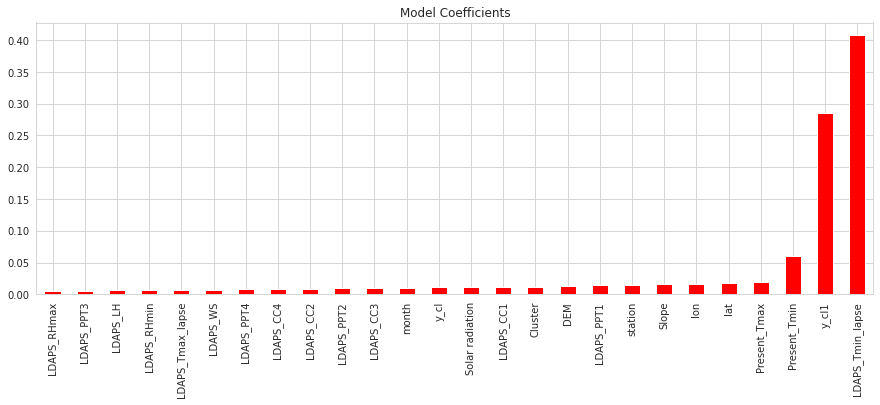

In [300]:
coef = pd.Series(xgr.feature_importances_, x.columns).sort_values()
plt.figure(figsize=(15,5))
coef.plot(kind='bar', title="Model Coefficients" , color = 'red')

In [301]:
from sklearn.model_selection import cross_validate
cv_results = cross_validate(XBR(), x, y2, cv=3)

xgr_score=cv_results['test_score'].mean()




[16:31:06] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[16:31:07] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[16:31:08] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


In [302]:
xgr_score

0.7699499543125509

## **Extra Tree Regressor**

In [303]:
from sklearn.tree import ExtraTreeRegressor as ETR 

etr = ETR()
etr.fit(x_train2, y_train2)
y_pred=etr.predict(x_test2)
from sklearn.metrics import mean_absolute_error as rms, r2_score
print(r2_score(y_test2,y_pred))
print(rms(y_test2,y_pred))
etr_e=r2_score(y_test2,y_pred)

0.7445458724435883
0.8963746223564955


In [304]:
from sklearn.model_selection import cross_validate
cv_results = cross_validate(ETR(), x, y2, cv=3)

etc_score=cv_results['test_score'].mean()


In [305]:
etc_score

0.49803263549533733

## **Support vector Regressor**

In [306]:
from sklearn.svm import SVR

svc = SVR()
svc.fit(x_train_scaler2, y_train2)
y_pred=svc.predict(x_test_scaler2)
from sklearn.metrics import mean_absolute_error as rms, r2_score
print(r2_score(y_test2,y_pred))
print(rms(y_test2,y_pred))
svm_e=r2_score(y_test2,y_pred)

0.9014319635042414
0.571959805595625


In [307]:
from sklearn.model_selection import cross_validate
cv_results = cross_validate(SVR(kernel='linear'), ss.transform(x), y2, cv=3)

svc_score=cv_results['test_score'].mean()


In [308]:
svc_score

0.7686626129182293

## **Comparing models**

In [309]:
score=[lr_reg,rid_reg,rfc_reg,xgr_score,etc_score,svc_score]
error=[lr_e,ridge_e,rfr_e,xgb_e,etr_e,svm_e]
name=['LR','Ridge','RFC','XGB','ETC','SVC']
diff=[]
for i in range(6):
  diff.append(score[i]-error[i])
pd.DataFrame([name,score,error,diff]).T

,0,1,2,3
0,LR,0.767652,0.83514,-0.0674876
1,Ridge,0.767667,0.835146,-0.0674785
2,RFC,0.753012,0.897779,-0.144767
3,XGB,0.76995,0.879579,-0.109629
4,ETC,0.498033,0.744546,-0.246513
5,SVC,0.768663,0.901432,-0.132769


Ridge is best selected model

# **Hyper-parameter tuning1** 

In [268]:
from sklearn.model_selection import GridSearchCV

param_grid = [
{'alpha': [1,5,10,15,20,25,30,35,40,50,60,70,80,90,100], 
 }
]

gsearch_ri = GridSearchCV(Ridge(), param_grid, cv=3 )
gsearch_ri.fit(ss.transform(x), y1)
print('Best score:', gsearch_ri.best_score_)
print('Best score:', gsearch_ri.best_params_)
print('Best score:', gsearch_ri.best_estimator_)

Best score: 0.7081479102398882
Best score: {'alpha': 50}
Best score: Ridge(alpha=50, copy_X=True, fit_intercept=True, max_iter=None, normalize=False,
      random_state=None, solver='auto', tol=0.001)


In [269]:
from sklearn.model_selection import cross_validate
cv_results = cross_validate(Ridge(alpha=50, copy_X=True, fit_intercept=True, max_iter=None, normalize=False,
      random_state=None, solver='auto', tol=0.001), ss.transform(x),y1, cv=10)

cv_results['test_score'].mean()

0.6401583913176265

# **Hyper-parameter tuning2** 

In [312]:
from sklearn.model_selection import GridSearchCV

param_grid = [
{'alpha': [1,5,10,15,20,25,30,35,40,50,60,70,80,90,100,110,120,130], 
 }
]

gsearch_ri = GridSearchCV(Ridge(), param_grid, cv=3 )
gsearch_ri.fit(ss.transform(x), y2)
print('Best score:', gsearch_ri.best_score_)
print('Best score:', gsearch_ri.best_params_)
print('Best score:', gsearch_ri.best_estimator_)

Best score: 0.7684041585630991
Best score: {'alpha': 120}
Best score: Ridge(alpha=120, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=None, solver='auto', tol=0.001)


In [314]:
from sklearn.model_selection import cross_validate
cv_results = cross_validate(Ridge(alpha=120, copy_X=True, fit_intercept=True, max_iter=None, normalize=False,
      random_state=None, solver='auto', tol=0.001), ss.transform(x),y2, cv=10)

cv_results['test_score'].mean()

0.7420300957846482

# **Best Model Evaluation1**

In [330]:
model=Ridge(alpha=50, copy_X=True, fit_intercept=True, max_iter=None, normalize=False,
      random_state=None, solver='auto', tol=0.001)
model.fit(ss.transform(x),y1)

Ridge(alpha=50, copy_X=True, fit_intercept=True, max_iter=None, normalize=False,
      random_state=None, solver='auto', tol=0.001)

In [331]:
y_pred = model.predict(ss.transform(x))
from sklearn.metrics import mean_squared_error as rms, r2_score
print(r2_score(y1,y_pred))
print(rms(y1,y_pred))

0.762508073180851
2.316642888471909


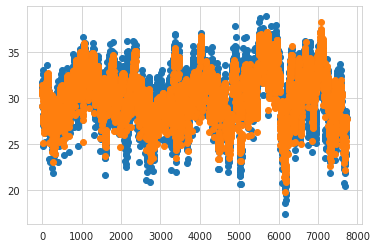

In [332]:
plt.scatter(x=y1.index,y=y1,cmap='blue')
plt.scatter(x=y1.index,y=y_pred,cmap='red')

(array([3.000e+00, 1.000e+01, 6.500e+01, 2.670e+02, 1.313e+03, 3.111e+03,
        2.212e+03, 5.350e+02, 1.710e+02, 3.600e+01]),
 array([-8.2255686 , -6.79179662, -5.35802464, -3.92425266, -2.49048068,
        -1.0567087 ,  0.37706328,  1.81083526,  3.24460724,  4.67837922,
         6.1121512 ]),
 <a list of 10 Patch objects>)

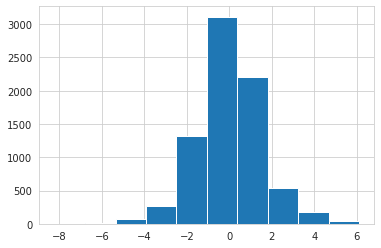

In [333]:
plt.hist((y_pred-y1))

# **Best Model Evaluation2**

In [326]:
model1=Ridge(alpha=120, copy_X=True, fit_intercept=True, max_iter=None, normalize=False,
      random_state=None, solver='auto', tol=0.001)
model1.fit(ss.transform(x),y2)

Ridge(alpha=120, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=None, solver='auto', tol=0.001)

In [327]:
y_pred = model1.predict(ss.transform(x))
from sklearn.metrics import mean_squared_error as rms, r2_score
print(r2_score(y2,y_pred))
print(rms(y1,y_pred))

0.8298013449475873
60.12115134708916


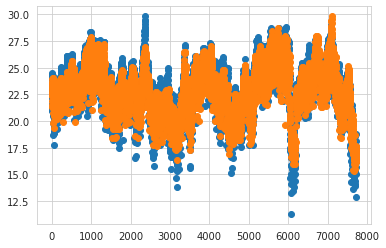

In [328]:
plt.scatter(x=y1.index,y=y2,cmap='blue')
plt.scatter(x=y1.index,y=y_pred,cmap='red')

(array([6.000e+00, 2.900e+01, 4.090e+02, 2.564e+03, 3.115e+03, 1.298e+03,
        2.540e+02, 4.200e+01, 4.000e+00, 2.000e+00]),
 array([-4.84038253, -3.71537885, -2.59037516, -1.46537148, -0.3403678 ,
         0.78463588,  1.90963957,  3.03464325,  4.15964693,  5.28465062,
         6.4096543 ]),
 <a list of 10 Patch objects>)

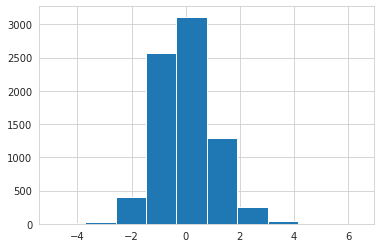

In [329]:
plt.hist((y_pred-y2))

# **Saving the model** 

In [334]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [335]:
import pickle

filename = '/content/drive/MyDrive/datatrained/temperature/model.sav'
pickle.dump(model, open(filename, 'wb'))

In [336]:

filename = '/content/drive/MyDrive/datatrained/temperature/model1.sav'
pickle.dump(model1, open(filename, 'wb'))

# **Conclusion**

In [337]:

filename = '/content/drive/MyDrive/datatrained/temperature/model.sav'
model = pickle.load(open(filename, 'rb'))

In [339]:

filename = '/content/drive/MyDrive/datatrained/temperature/model1.sav'
model1 = pickle.load(open(filename, 'rb'))

In [341]:
y_pred = model.predict(ss.transform(x))
from sklearn.metrics import mean_squared_error as rms, r2_score
print(r2_score(y1,y_pred))
print(rms(y1,y_pred))


0.762508073180851
2.316642888471909


In [344]:
y_pred1 = model1.predict(ss.transform(x))
from sklearn.metrics import mean_squared_error as rms, r2_score
print(r2_score(y2,y_pred1))
print(rms(y2,y_pred1))


0.8298013449475873
1.0493412086634155


In [345]:
pd.concat([pd.DataFrame(y_pred),pd.DataFrame(y1)],axis=1).T

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,7683,7684,7685,7686,7687,7688,7689,7690,7691,7692,7693,7694,7695,7696,7697,7698,7699,7700,7701,7702,7703,7704,7705,7706,7707,7708,7709,7710,7711,7712,7713,7714,7715,7716,7717,7718,7719,7720,7721,7722
0,29.14074,30.878055,30.638273,31.414583,30.680844,30.459758,30.894827,30.559564,30.340025,29.687565,30.884296,29.954075,31.119145,30.581361,31.154631,30.543109,30.909213,31.02683,30.794906,30.70437,30.995482,31.105946,31.308129,31.122396,31.352358,25.060712,27.461046,28.030349,27.511056,27.541718,27.874629,27.74019,27.808688,27.269548,26.23481,28.386577,27.342327,28.488398,28.09487,28.03678,...,24.561666,23.622438,24.634545,24.430287,24.542248,24.213454,24.432502,24.591061,24.573219,23.32803,24.636747,24.742403,24.947605,24.856646,24.703868,25.335966,27.204827,27.344531,27.114698,27.120252,27.389853,27.694439,27.498627,27.635745,26.786106,27.63183,26.732301,27.856036,27.573823,27.581784,27.353769,27.4603,27.712339,27.341775,26.926309,27.678347,27.68136,27.860548,27.914854,27.776195
Next_Tmax,29.10000,30.500000,31.100000,31.700000,31.200000,31.500000,30.900000,31.100000,31.300000,30.500000,31.200000,32.600000,31.400000,31.700000,30.800000,30.800000,31.500000,33.10000,31.800000,30.80000,30.600000,32.600000,31.800000,31.300000,32.000000,24.800000,27.300000,28.100000,27.900000,28.200000,28.900000,27.60000,28.200000,27.100000,27.50000,28.900000,26.800000,28.700000,27.90000,27.10000,...,23.500000,23.800000,24.200000,23.500000,23.500000,22.100000,23.000000,24.000000,22.900000,22.80000,23.600000,23.000000,23.800000,24.000000,23.800000,23.800000,26.500000,27.700000,26.900000,27.900000,28.100000,27.800000,27.500000,27.400000,26.200000,27.40000,25.800000,27.800000,27.500000,27.200000,25.900000,26.8000,27.800000,27.100000,26.700000,27.600000,28.00000,28.300000,28.600000,27.800000


In [346]:
pd.concat([pd.DataFrame(y_pred1),pd.DataFrame(y2)],axis=1).T

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,7683,7684,7685,7686,7687,7688,7689,7690,7691,7692,7693,7694,7695,7696,7697,7698,7699,7700,7701,7702,7703,7704,7705,7706,7707,7708,7709,7710,7711,7712,7713,7714,7715,7716,7717,7718,7719,7720,7721,7722
0,21.296097,22.761623,23.353784,23.369923,22.58287,22.966238,23.541394,23.239306,22.411281,21.537974,23.520074,22.335277,23.603075,23.518418,23.945517,22.520372,21.908446,23.160926,23.402937,22.580383,23.730782,23.320839,23.898383,24.047205,23.98564,19.862011,22.012461,22.642409,22.672863,22.319853,22.437276,22.390249,22.292369,21.6096,20.758461,22.985353,21.22845,22.990047,22.367943,22.335458,...,17.334068,15.923698,17.228044,17.077798,16.755515,16.905133,16.250931,17.156471,16.282311,16.65594,17.235934,17.339235,17.050268,17.096885,17.169916,15.462561,16.595938,17.114694,16.935698,16.937108,17.160088,17.443084,17.256073,16.965543,16.118642,17.201488,16.22949,17.286625,17.542732,17.353245,16.758187,16.332367,17.400308,16.757291,16.503856,17.509133,17.239763,17.560853,17.646332,17.588218
Next_Tmin,21.200000,22.500000,23.900000,24.300000,22.50000,24.000000,23.400000,22.900000,21.600000,21.000000,24.500000,22.200000,24.300000,22.900000,22.800000,20.900000,21.100000,23.900000,21.600000,23.000000,24.000000,23.700000,23.200000,23.700000,24.20000,18.700000,21.500000,21.800000,21.500000,22.200000,22.300000,21.200000,21.300000,21.0000,20.700000,22.500000,19.80000,22.300000,21.500000,20.700000,...,16.200000,15.200000,17.000000,16.600000,15.800000,15.100000,14.100000,17.800000,14.400000,15.40000,17.800000,17.300000,17.000000,17.600000,17.400000,15.100000,15.400000,16.800000,17.000000,15.700000,17.500000,18.600000,16.600000,16.400000,15.000000,16.200000,16.50000,17.400000,17.200000,17.500000,15.700000,12.900000,16.700000,16.600000,16.300000,17.700000,17.100000,18.100000,18.800000,17.400000
